# After imputing the training and test datasets, it's about time we do some feature engineering to create/delete some features based on their relevance.

In [1]:
import pandas as pd
import numpy as np

# Visualization
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.express as px

# Automatic data analysis
from ydata_profiling import ProfileReport
# Statistics
from scipy import stats
import distfit 
from distfit import distfit

from tqdm import tqdm

In [2]:
df_train = pd.read_csv("../data/imputed/train.csv")
df_test = pd.read_csv("../data/imputed/test.csv")

<a id="1"></a>
# 1 **Feature engineering**

<a id="1.1"></a>
## 1.1 **Create "Consumption_High_End" and "Consumption_Basic"**

<font size="4">According to 3.2.3.2.2 in EDA.ipynb, we shall create a new feature to be the aggregate expenditure of the three terms "RoomService", "Spa" and "VRDeck".</font>

<font size="4">Let's name it "Consumption_High_End".</font>

In [3]:
df_train["Consumption_High_End"] = df_train["RoomService"] + df_train["Spa"] + df_train["VRDeck"]

In [4]:
df_train["Consumption_Basic"] = df_train["FoodCourt"] + df_train["ShoppingMall"]

<a id="1.2"></a>
## 1.2 **Bin Age**

<font size="4">We know from our observation in EDA that it is appropriate to bin Age into age groups.</font>

<font size="4">Therefore, we create "Age_group" made up of 4 categories: "Minor"(0-18), "Young Adults"(18-40), "Middle-aged"(40-60), "Senior"(60-).</font>

In [5]:
# Define the bins and labels
bins = [0, 18, 40, 60, float('inf')]  # Using float('inf') to include all higher numbers
labels = ['Minor', 'Young adults', 'Middle-aged', 'Senior']

In [6]:
# Use pd.cut to bin the age data
df_train['Age_group'] = pd.cut(df_train['Age'], bins=bins, labels=labels, right=False)  # right=False means the intervals are left-inclusive

<a id="1.3"></a>
## 1.3 **Remove corresponding old features**

In [7]:
df_train = df_train.drop(columns=["Age", "ID_num","Cabin_side"])

In [8]:
df_train

,CryoSleep,Destination,VIP,Cabin_deck,Group_size,HomePlanet,Transported,Consumption_High_End,Consumption_Basic,Age_group
0,False,TRAPPIST-1e,False,B,1,Europa,0,0.0,0.0,Young adults
1,False,TRAPPIST-1e,False,F,1,Earth,1,702.0,34.0,Young adults
2,False,TRAPPIST-1e,True,A,2,Europa,0,6807.0,3576.0,Middle-aged
3,False,TRAPPIST-1e,False,A,2,Europa,0,3522.0,1654.0,Young adults
4,False,TRAPPIST-1e,False,F,1,Earth,1,870.0,221.0,Minor
...,...,...,...,...,...,...,...,...,...,...
8688,False,55 Cancri e,True,A,1,Europa,0,1717.0,6819.0,Middle-aged
8689,True,PSO J318.5-22,False,G,1,Earth,0,0.0,0.0,Young adults
8690,False,TRAPPIST-1e,False,G,1,Earth,1,1.0,1872.0,Young adults
8691,False,55 Cancri e,False,E,2,Europa,0,3588.0,1049.0,Young adults


<a id="2"></a>
# 2 **EDA verification of engineered features**

<a id="2.1"></a>
## 2.1 **Age_group**

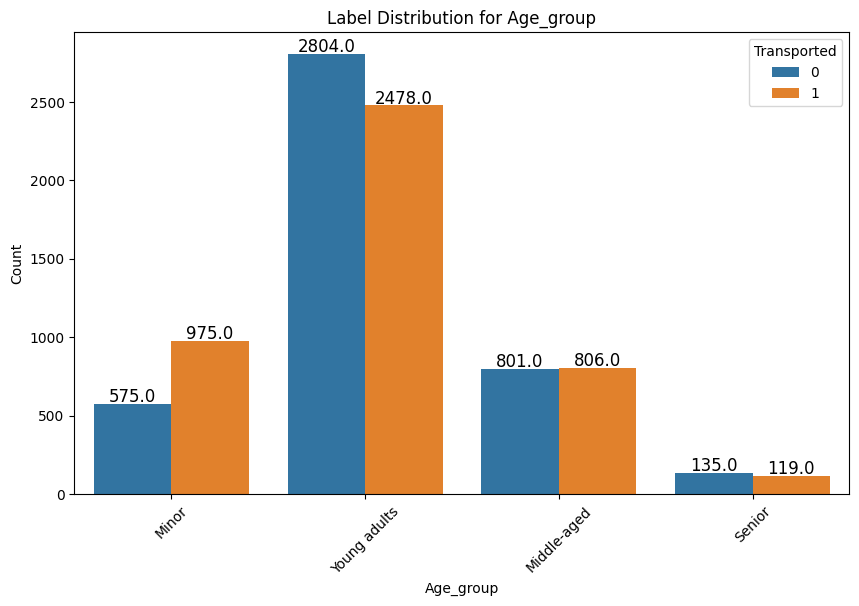

In [11]:
    plt.figure(figsize=(10, 6))  # Adjust the figure size as needed
    ax = sns.countplot(x="Age_group", hue='Transported', data=df_train)
    plt.title(f'Label Distribution for Age_group')
    plt.xlabel("Age_group")
    plt.ylabel('Count')
    plt.xticks(rotation=45)  # Rotate x-axis labels for better readability if necessary
    for p in ax.patches:
        ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center', fontsize=12, color='black', xytext=(0, 5),
                    textcoords='offset points')
    plt.show()

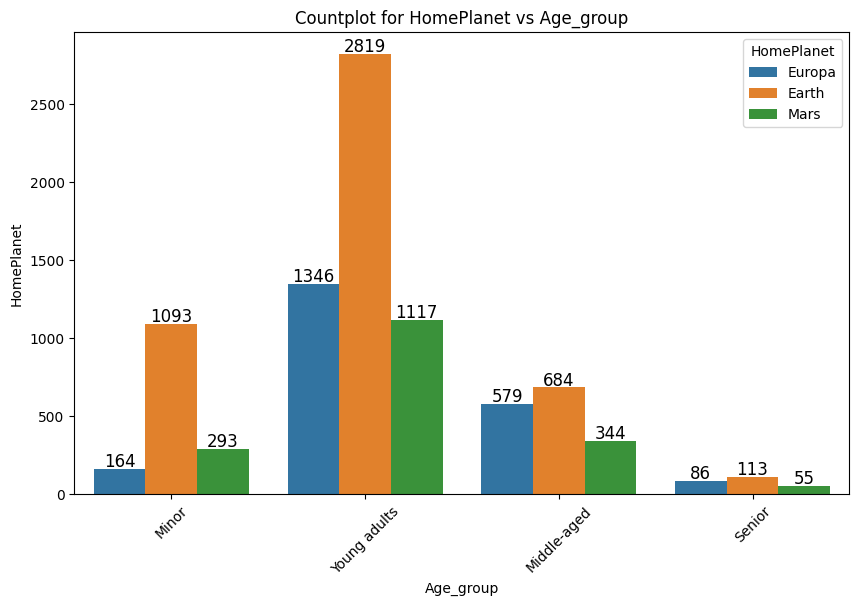

In [12]:
plt.figure(figsize=(10, 6))  # Adjust the figure size as needed
ax = sns.countplot(x='Age_group', hue='HomePlanet', data=df_train)
for p in ax.patches:
    value = '{:.0f}'.format(p.get_height())  # Format to 2 decimal places
    ax.annotate(value, (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=12, color='black', xytext=(0, 5),
                textcoords='offset points')
plt.title(f'Countplot for HomePlanet vs Age_group')
plt.xlabel('Age_group')
plt.ylabel('HomePlanet')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability if necessary
plt.show()

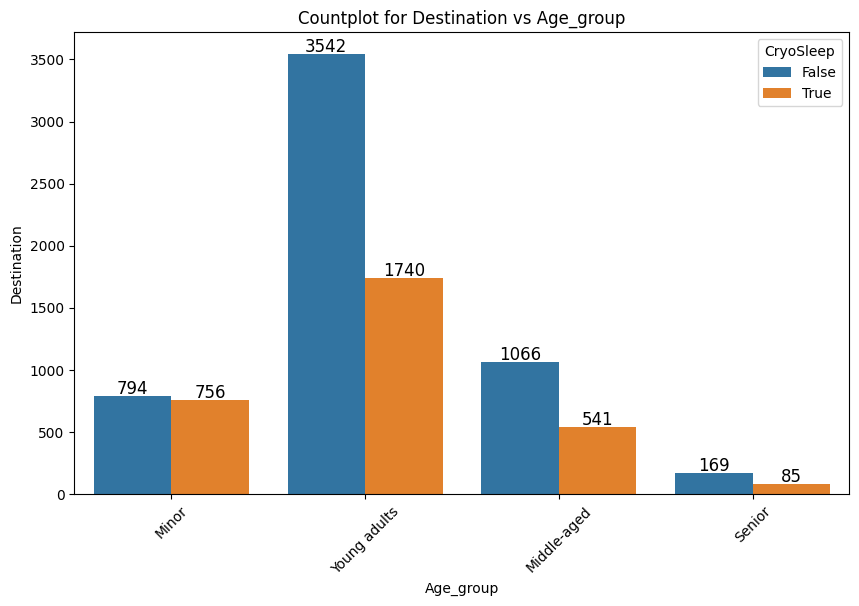

In [13]:
plt.figure(figsize=(10, 6))  # Adjust the figure size as needed
ax = sns.countplot(x='Age_group', hue='CryoSleep', data=df_train)
for p in ax.patches:
    value = '{:.0f}'.format(p.get_height())  # Format to 2 decimal places
    ax.annotate(value, (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=12, color='black', xytext=(0, 5),
                textcoords='offset points')
plt.title(f'Countplot for Destination vs Age_group')
plt.xlabel('Age_group')
plt.ylabel('Destination')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability if necessary
plt.show()

In [14]:
expenses = ["Consumption_High_End", "Consumption_Basic"]

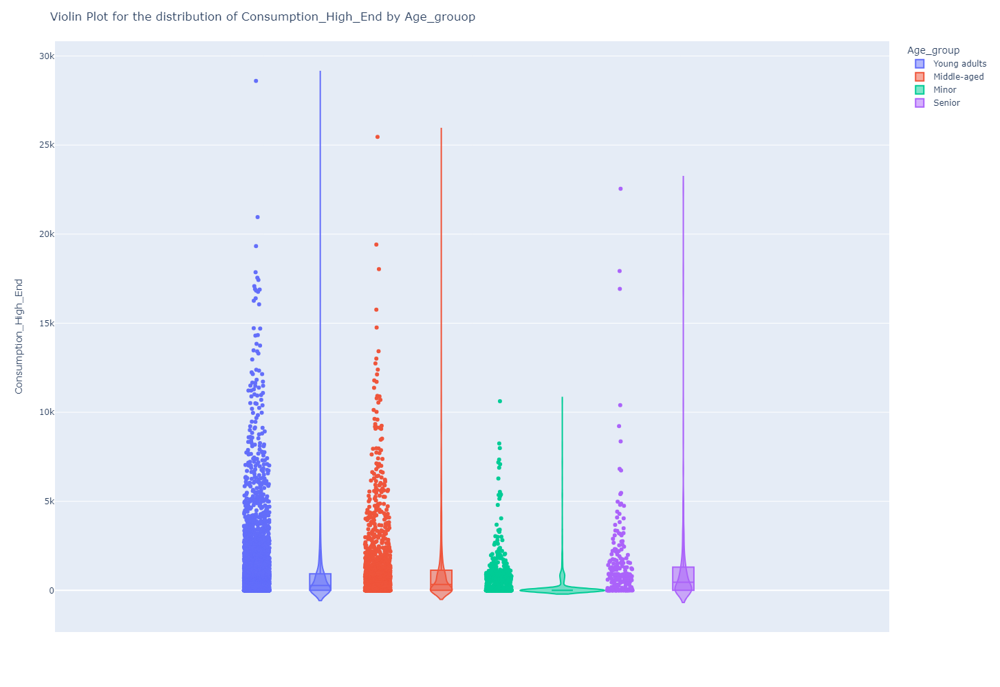

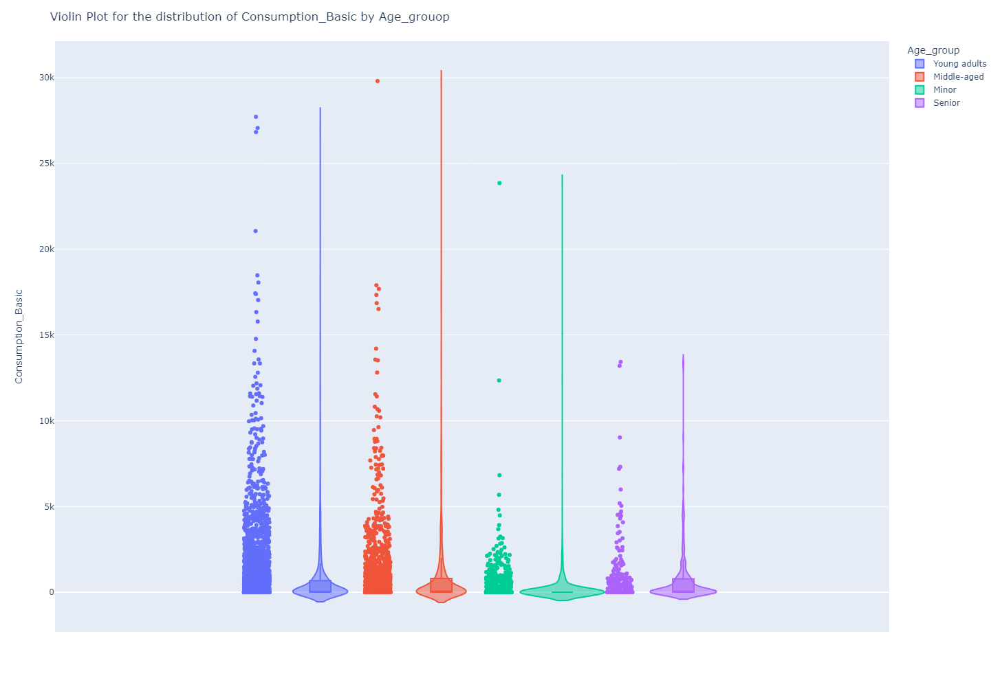

In [16]:
for i in expenses:
    fig = px.violin(df_train, y=i,  color="Age_group", box=True, points="all",
          hover_data=df_train.columns)
    fig.update_layout(
        width=1200,  # Set the width here
        height=1000,  # Set the height here
        title_text=f'Violin Plot for the distribution of {i} by Age_grouop'
    )
    fig.show()

<a id="2.2"></a>
## 2.2 **Consumption_High_End**

In [42]:
cat = ['CryoSleep', 'Destination', 'VIP', 'Cabin_deck', 'Group_size',
       'HomePlanet', 'Cabin_side', 'Age_group']

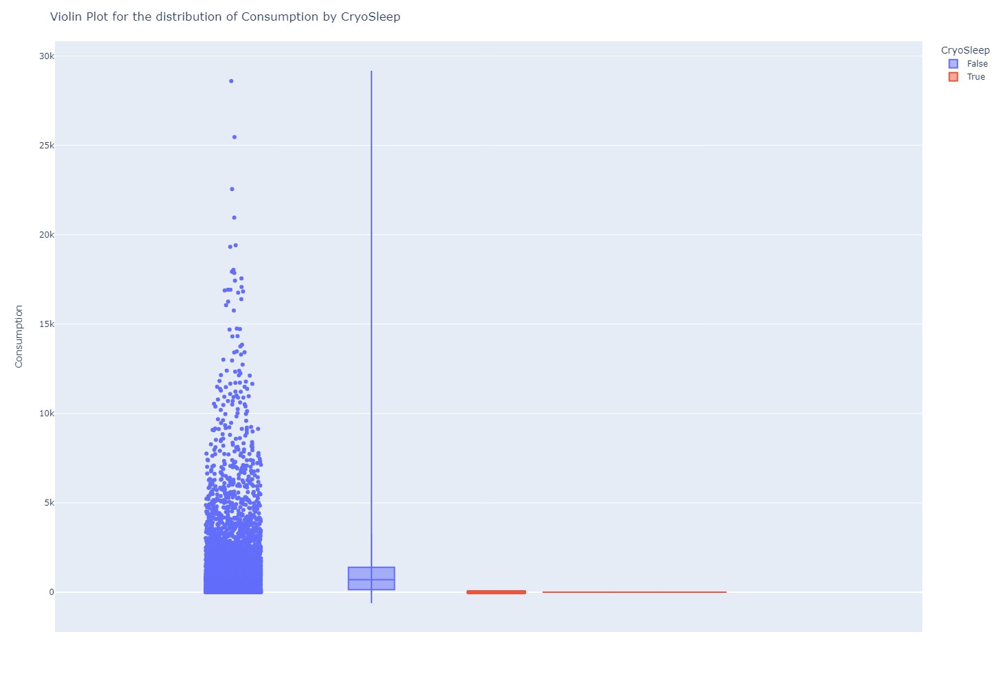

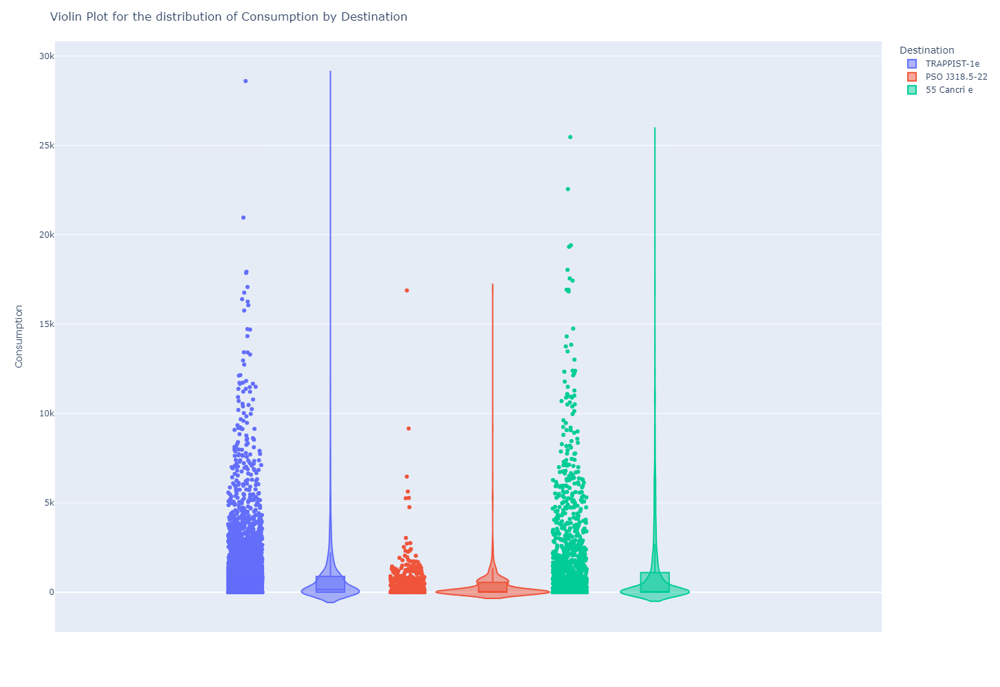

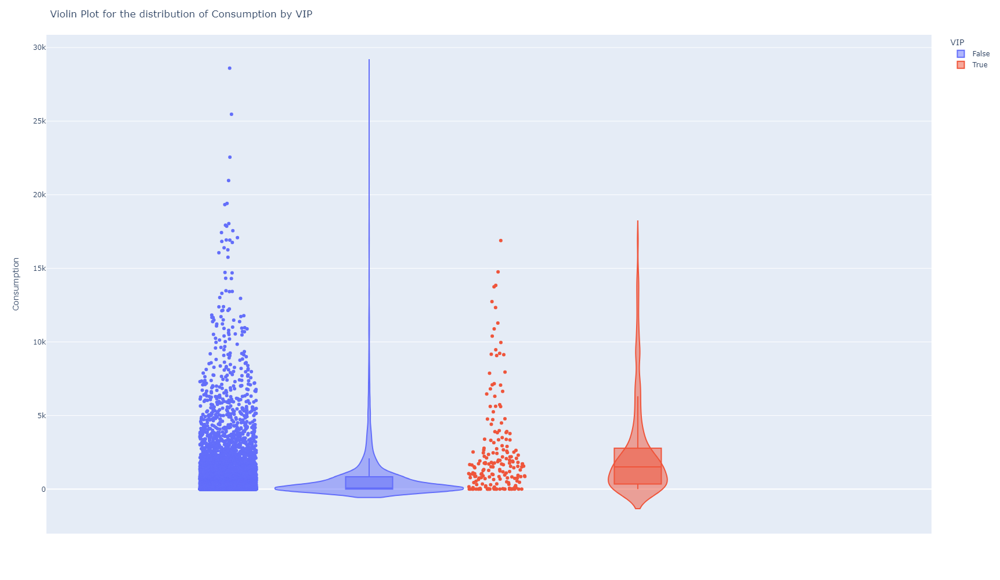

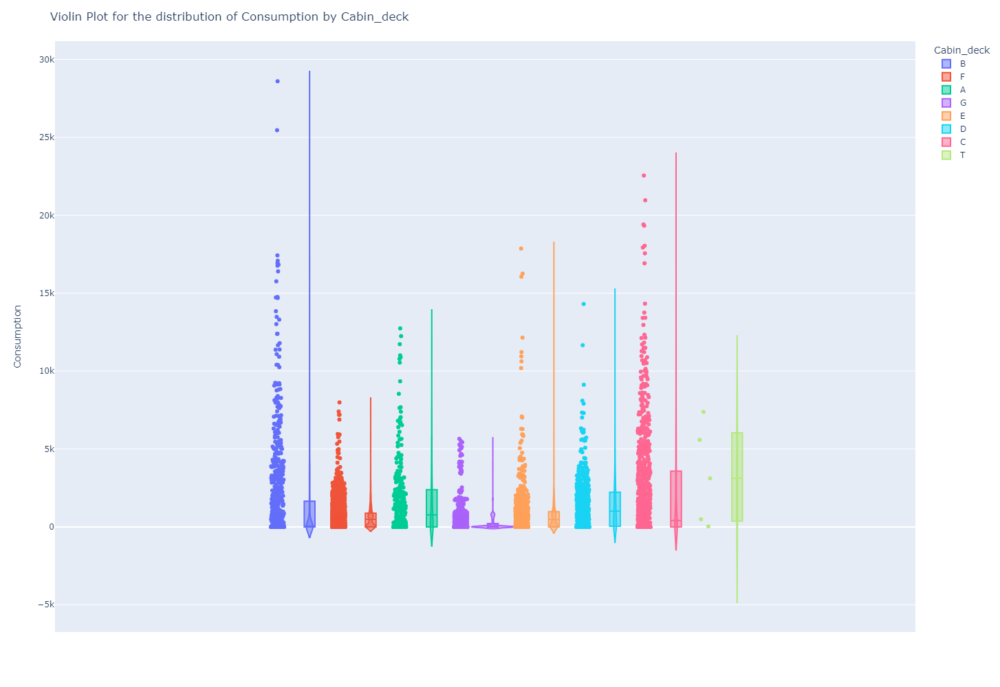

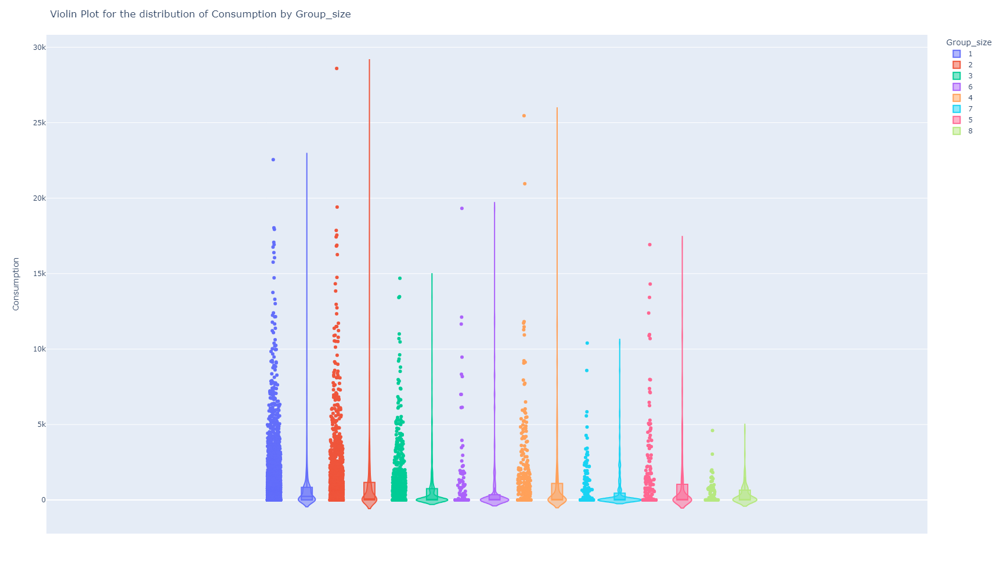

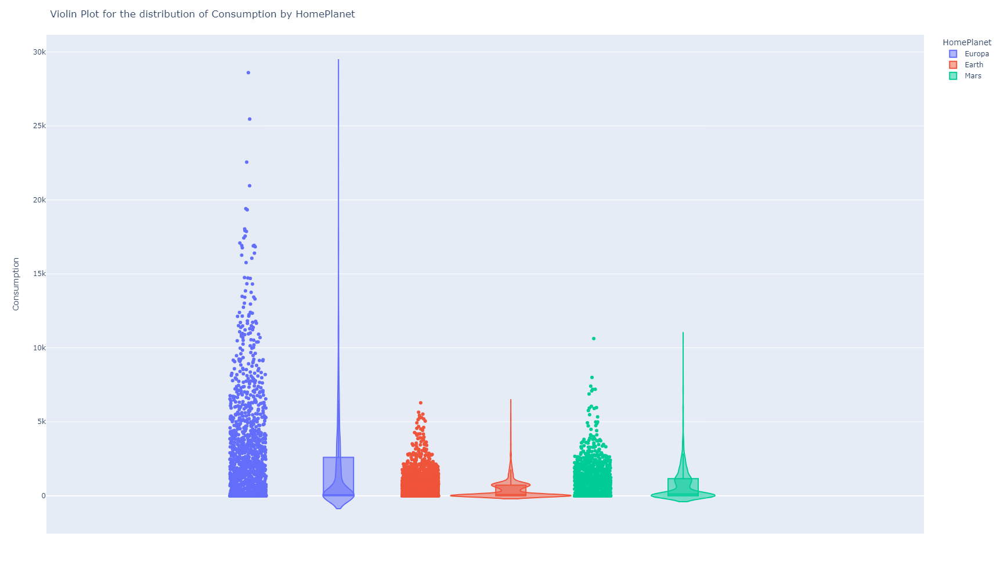

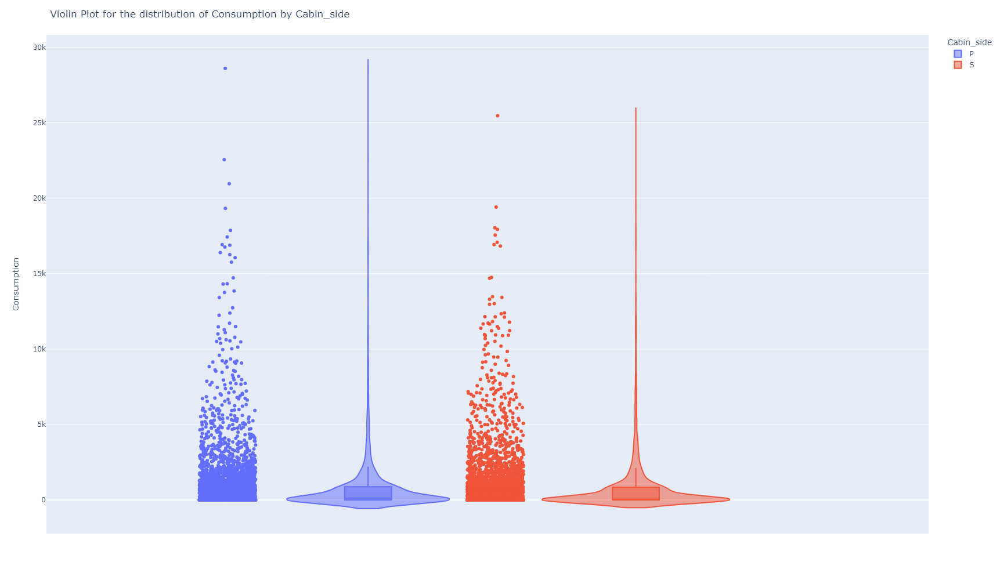

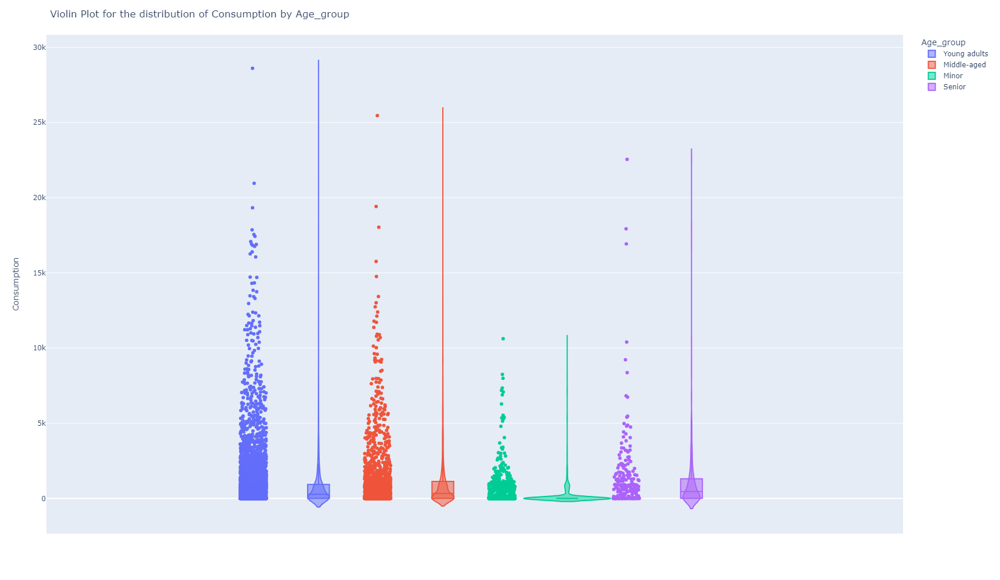

In [44]:
for i in cat:
    fig = px.violin(df_train, y="Consumption",  color=i, box=True, points="all",
          hover_data=df_train.columns)
    fig.update_layout(
        width=1200,  # Set the width here
        height=1000,  # Set the height here
        title_text=f'Violin Plot for the distribution of Consumption by {i}'
    )
    fig.show()